## Imports

In [9]:
using ChaosTools
using DifferentialEquations
using Plots
using LinearAlgebra
using Plots.PlotMeasures
using LaTeXStrings
using JLD2
using NPZ
using Distributions
using DynamicalSystems
using FFTW

In [1]:
include("Network.jl")
include("HomogeneousSystem.jl")

Main.HomogeneousSystem

### Parameter Structure

In [10]:
# Define a parameter struct that contains the scalar parameters and the matrix
struct Params
    scalar_params::Vector{Float64}  # Vector of scalar parameters (e.g., p[1], p[2], ...)
    matrix_params::Matrix{Float64}  # The normalized connectivity matrix
end

## Integrate homogeneous system to find point on periodic orbit

In [476]:
# Initial conditions (size should match the system, here we have a 2D system)
u0 = zeros(6)

# Time span
# Initial time
t0 = 0
# Final time
tf = 2000
tspan = (t0, tf)

# Define the parameters as a dictionary
p = [8,8,1,5,-5,-5,1,1,5,13,5,13,0,11.5,5];

In [477]:
# Define the problem using the system and parameters
prob = ODEProblem(HomogeneousSystem.HomogeneousSystem!, u0, tspan, p)
# Solve the ODE problem using RK45
sol = solve(prob,reltol = 1e-6,abstol = 1e-6,saveat=0.01);

In [ ]:
# Set initial condition for the network
Nvariables = 6
Npop = 90

u0 = zeros(Npop*Nvariables)
u0[1:Npop] = fill(fin[1],Npop)
u0[1+Npop:2*Npop] = fill(fin[2],Npop)
u0[1+2*Npop:3*Npop] = fill(fin[3],Npop)
u0[1+3*Npop:4*Npop] = fill(fin[4],Npop)
u0[1+4*Npop:5*Npop] = fill(fin[5],Npop)
u0[1+5*Npop:end] = fill(fin[6],Npop)
u0

540-element Vector{Float64}:
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 0.033006060172913715
 ⋮
 0.10604119471723883
 0.10604119471723883
 0.10604119471723883
 0.10604119471723883
 0.10604119471723883
 0.10604119471723883
 0.10604119471723883
 0.10604119471723883
 0.10604119471723883

In [516]:
Nvariables = 6
Npop = 90

# Define the normal distribution (mean=0, standard deviation=1)
dist = Normal(0, 0.01)

# Generate a random vector of size 10 with values from the normal distribution
random_vector = rand(dist, Npop*Nvariables)

# Initial conditions (size should match the system, here we have a 2D system)
u0 .+= random_vector

# Time span
# Initial time
t0 = 0
# Final time
tf = 10000
tspan = (t0, tf)

# Define the parameters as a dictionary
scalar_params = [8,8,1,5,-5,-5,1,1,5,13,5,13,0,9.5,9];

# Load the .npz file containing the connectivity matrix into a dictionary-like structure
data = load("NormalizedMatrix.npz")
W = data["normalized_matrix"]

# Create the Params struct
p = Params(scalar_params, W)

Params([8.0, 8.0, 1.0, 5.0, -5.0, -5.0, 1.0, 1.0, 5.0, 13.0, 5.0, 13.0, 0.0, 9.5, 9.0], [0.0 0.07150787333365484 … 0.029938437471751827 0.0457088009950454; 0.040356800998807764 0.0 … 0.0844727476667492 0.0069661426632191365; … ; 0.011030461432017217 0.05514665431799544 … 0.0 0.055906608276557586; 0.029621282116852266 0.007999004709306763 … 0.09833390557208707 0.0])

## Integrating with Differential Equations solve

In [517]:
# Define the problem using the system and parameters
prob = ODEProblem(Network.Network!, u0, tspan, p)

ODEProblem with uType Vector{Float64} and tType Int64. In-place: true
Non-trivial mass matrix: false
timespan: (0, 10000)
u0: 540-element Vector{Float64}:
 0.00493433024015778
 0.048158802576083806
 0.029977849319399313
 0.051490958364113874
 0.01911618519441357
 0.034053133410910444
 0.043119578786162904
 0.024906560845886945
 0.019928359978921194
 0.04625894936314644
 ⋮
 0.08068144551591971
 0.09830595405618515
 0.08473742620755627
 0.10478385153116135
 0.10208853177496865
 0.12618059626014183
 0.12735294241111125
 0.11549621662359551
 0.09163821912016136

In [ ]:
# Solve the ODE problem using RK45

#@profview sol = solve(prob,reltol = 1e-6,abstol = 1e-6,saveat=0.001);
sol = solve(prob,reltol = 1e-6,abstol = 1e-6,saveat=0.01,RK4();dt = 0.01,adaptive=false);

In [519]:
size(sol)

(540, 1000001)

In [520]:
# Unpack state variables
#r_e, v_e, s_e, r_i, v_i, s_i = u
idx_ve = 1
idx_se = 2
idx_ri = 3
idx_vi = 4
idx_si = 5
@inbounds r_e_vector = @view sol[1:90,:]
@inbounds v_e_vector = @view sol[90*idx_ve+1:90*idx_se,:]
@inbounds s_e_vector = @view sol[90*idx_se+1:90*idx_ri,:]
@inbounds r_i_vector = @view sol[90*idx_ri+1:90*idx_vi,:]
@inbounds v_i_vector = @view sol[90*idx_vi+1:90*idx_si,:]
@inbounds s_i_vector = @view sol[90*idx_si+1:90*6,:]

90×1000001 view(::ODESolution{Float64, 2, Vector{Vector{Float64}}, Nothing, Nothing, Vector{Float64}, Vector{Vector{Vector{Float64}}}, Nothing, ODEProblem{Vector{Float64}, Tuple{Float64, Float64}, true, Params, ODEFunction{true, SciMLBase.AutoSpecialize, FunctionWrappersWrappers.FunctionWrappersWrapper{Tuple{FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{Float64}, Vector{Float64}, Params, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Params, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{Float64}, Params, ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{Forward

In [486]:
size(v_e_vector)

(90, 1000001)

## $\epsilon=12, I_{ext}^E=8$

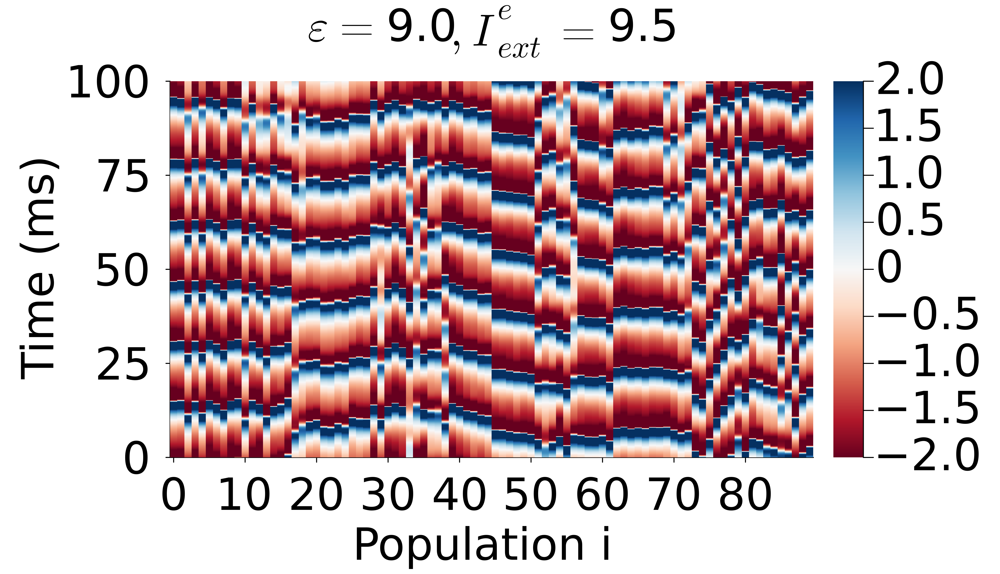

In [ ]:
# Set the backend to GR
gr()  
vmin = -2
vmax = 2
idx_ms = 100
step = 0.01
# Loop over each column and plot it in a different color
plt= heatmap()
heatmap(1:Npop,sol.t[end-Int(floor(idx_ms/step)):end],transpose(v_e_vector[:,end-Int(floor(idx_ms/step)):end]), color=:RdBu,clims=(-2, 2),left_margin=2cm,right_margin=2cm,colorbar = true, colorbar_position = :right,dpi=500)

# Set labels
xlabel!("Population i ",xguidefontsize=30,bottom_margin = 10mm)
ylabel!("Time (ms)",yguidefontsize=30,left_margin = 10mm)

# Tick positions and numeric labels
xtick_positions = [1, 11, 21, 31, 41, 51, 61, 71, 81]
xtick_labels = [0, 10, 20, 30, 40, 50, 60, 70, 80]
ytick_positions = [9900, 9925, 9950, 9975,10000]
ytick_labels = [0,25,50,75,100]

plot!(xticks=(xtick_positions, xtick_labels),yticks=(ytick_positions, ytick_labels),xtickfont=30,ytickfont=30,tick_direction = :out,)
# Set the legend to have two columns
#plot!(legend=:outertop, legendfontsize=5,legendcolumns=3)

# Set the figure size (make it wider)
plot!(title=L"\epsilon = " * string(p.scalar_params[15]) * L", I_{ext}^e = " * string(p.scalar_params[14]),titlefont = font(30),top_margin = 10mm)
plot!(size=(1000, 575)) 
#savefig("Fourier10/NonPerturbedSimeps=" * string(p.scalar_params[15]) * "_Iext_e=" * string(p.scalar_params[14]) * ".png")
plot!(size=(1000, 575)) 


## Compute Power Spectrum all nodes

In [548]:
delta = 0.01/1000 #Sampling rate
samFrec = 1/delta #Sampling frequency

99999.99999999999

In [549]:
size(v_e_vector)

(90, 1000001)

In [553]:
no_offset = v_e_vector[:,Int(1000/0.01):end].-mean(v_e_vector[:,Int(1000/0.01):end],dims=1)

90×900002 Matrix{Float64}:
 -0.51211      -0.515609    -0.519104   …  -1.19608   -1.19292   -1.18989
  1.8112        1.81874      1.82628       -1.02413   -1.02129   -1.01857
  1.37171       1.38005      1.38844        0.14556    0.147715   0.149749
  0.574998      0.566739     0.558369      -1.12965   -1.12655   -1.12358
 -0.000810032  -0.00773603  -0.0147066     -0.371959  -0.369916  -0.367991
 -1.20909      -1.2076      -1.20608    …  -1.24876   -1.24574   -1.24285
  0.890304      0.897522     0.904794      -0.928543  -0.925924  -0.923428
 -0.534505     -0.531075    -0.527617      -0.242736  -0.240245  -0.237871
 -1.19769      -1.19609     -1.19448       -1.24553   -1.24261   -1.23982
 -0.895346     -0.893627    -0.891889      -1.0071    -1.00421   -1.00145
  ⋮                                     ⋱              ⋮         
  0.207653      0.208564     0.209484      -2.7679    -2.89624   -3.02036
 -1.35135      -1.35014     -1.34892       -3.67577   -3.66317   -3.65006
 -0.959443     

In [554]:
matrix_PSD = M = Matrix{Float64}(undef, Npop, Int(floor(length(sol.t[Int(1000/0.01):end])/2)))

for idx in axes(matrix_PSD,1)
    #Set current signal
    current_signal = no_offset[idx,:]

    # Compute FFT
    F = fft(current_signal)
    freqs =  fftfreq(length(sol.t[Int(1000/0.01):end]), samFrec)

    # Select only half frequency spectrum
    half_idx = Int(floor(length(freqs)/2+1))
    F = F[2:half_idx]
    freqs = freqs[2:half_idx]

    # Normalize abs value FFT
    normalized = ((abs.(F)).^2)./maximum((abs.(F)).^2)

    # Save current data
    matrix_PSD[idx,:] = 10*log10.(normalized)
end
    


In [555]:
freqs =  fftfreq(length(sol.t), samFrec)
half_idx = Int(floor(length(freqs)/2+1))
freqs = freqs[2:half_idx]

500000-element Vector{Float64}:
     0.09999990000009999
     0.19999980000019998
     0.29999970000029996
     0.39999960000039997
     0.4999995000005
     0.5999994000005999
     0.6999993000007
     0.7999992000007999
     0.8999991000008999
     0.999999000001
     ⋮
 49999.15000084999
 49999.25000075
 49999.350000649996
 49999.450000549994
 49999.55000045
 49999.65000035
 49999.750000249995
 49999.85000014999
 49999.95000005

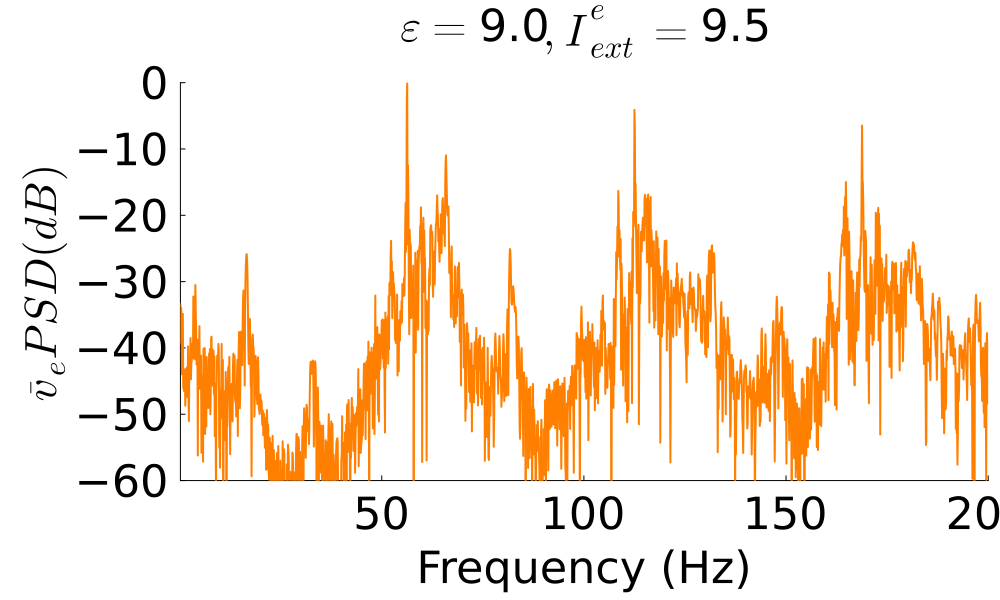

In [558]:
gr()
plot = scatter()
plot!(freqs[2:2001],matrix_PSD[1,2:2001],linewidth=2,grid=false,legend=false,color="darkorange1")
plot!(xtickfont=30,ytickfont=30,xlims=(freqs[2],200),ylims=(-60,0))
plot!(title=L"\epsilon = " * string(p.scalar_params[15]) * L", I_{ext}^e = " * string(p.scalar_params[14]) ,titlefont = font(30),top_margin = 10mm,left_margin=20mm)
xlabel!("Frequency (Hz)",xguidefontsize=30,bottom_margin = 10mm)
ylabel!(L"\bar{v}_e PSD (dB)",yguidefontsize=30,left_margin = 10mm)
plot!(xtickfont=30,ytickfont=30)
plot!(size=(1000, 600))
#savefig(plot,"Definitive/PSDMean_eps" * string(p.scalar_params[15])*".png")
#display(plot)

In [559]:
freqs[2:2000]

1999-element Vector{Float64}:
   0.19999980000019998
   0.29999970000029996
   0.39999960000039997
   0.4999995000005
   0.5999994000005999
   0.6999993000007
   0.7999992000007999
   0.8999991000008999
   0.999999000001
   1.0999989000011
   ⋮
 199.19980080019917
 199.29980070019928
 199.39980060019937
 199.49980050019948
 199.5998004001996
 199.69980030019968
 199.7998002001998
 199.89980010019988
 199.9998000002

In [560]:
size(matrix_PSD)

(90, 450001)

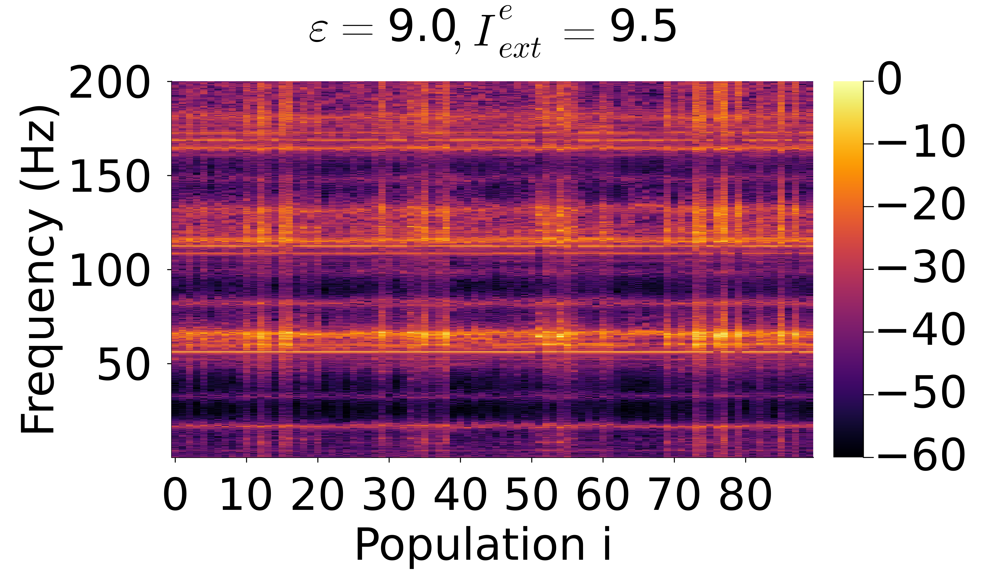

In [562]:
# Set the backend to GR
gr()  
vmin = -2
vmax = 2
idx_ms = 100
step = 0.01
# Loop over each column and plot it in a different color
plt= heatmap()
heatmap(1:90,freqs[2:2001],transpose(matrix_PSD[:,2:2001]), color=:inferno,clims=(-60, 0),left_margin=2cm,right_margin=2cm,colorbar = true, colorbar_position = :right,dpi=500)
# Set title
#plot!(title=L"\epsilon = " * string(p[15]) * L", I_{ext}^e = " * string(p[14]),titlefont = font(20),top_margin = 10mm)
# Set labels
xlabel!("Population i ",xguidefontsize=30,bottom_margin = 10mm)
ylabel!("Frequency (Hz)",yguidefontsize=30,left_margin = 10mm)

# Tick positions and numeric labels
xtick_positions = [1, 11, 21, 31, 41, 51, 61, 71, 81]
xtick_labels = [0, 10, 20, 30, 40, 50, 60, 70, 80]
#ytick_positions = [9900, 9925, 9950, 9975,10000]
#ytick_labels = [0,25,50,75,100]
plot!(xticks=(xtick_positions, xtick_labels),xtickfont=30,ytickfont=30,tick_direction = :out)
#plot!(xtickfont=30,ytickfont=30,tick_direction = :out)
# Set the legend to have two columns
#plot!(legend=:outertop, legendfontsize=5,legendcolumns=3)
# Set the figure size (make it wider)
plot!(title=L"\epsilon = " * string(p.scalar_params[15]) * L", I_{ext}^e = " * string(p.scalar_params[14]),titlefont = font(30),top_margin = 10mm)
plot!(size=(1000, 575)) 
savefig("Fourier10/Sim_eps=" * string(p.scalar_params[15]) * "_Iext_e=" * string(p.scalar_params[14]) * ".png")
plot!(size=(1000, 575)) 

## Compute mean and its PSD

In [563]:
size(v_e_vector)

(90, 1000001)

In [564]:
mean_ve = mean(v_e_vector,dims=1)

1×1000001 Matrix{Float64}:
 -1.65501  -1.65392  -1.65283  -1.65173  …  -0.682498  -0.683884  -0.685149

In [565]:
size(mean_ve)

(1, 1000001)

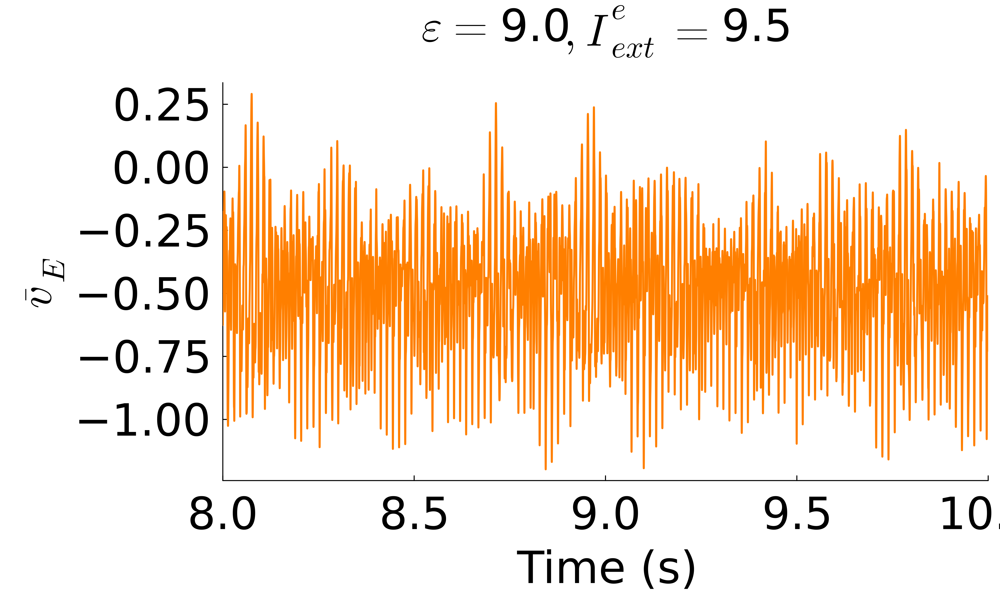

In [574]:
idx_ms = 2000
step = 0.01

gr()  # Set the backend to GR
plot= scatter()
# Loop over each column and plot it in a different color
plot!(sol.t[end-Int(floor(idx_ms/step)):end]/1000,mean_ve[1,end-Int(floor(idx_ms/step)):end],linewidth=2,markerstrokewidth=0,grid=false,legend=false,xticks=8:0.5:10,color="darkorange1",dpi=500)

# Set title
plot!(title=L"\epsilon = " * string(p.scalar_params[15]) * L", I_{ext}^e = " * string(p.scalar_params[14]) ,titlefont = font(30),top_margin = 10mm,left_margin=20mm,xlims=(8, 10))
# Set labels
xlabel!("Time (s)",xguidefontsize=30,bottom_margin = 10mm)
ylabel!(L"\bar{v}_E",yguidefontsize=30,left_margin = 10mm)
plot!(xtickfont=30,ytickfont=30)
# Set the legend to have two columns
#plot!(legend=:outertop, legendfontsize=5,legendcolumns=1)
# Set the figure size (make it wider)
plot!(size=(1000, 600)) 
savefig(plot,"Fourier10/Modulation_eps" * string(p.scalar_params[15])*".png")
display(plot) 

In [567]:
delta = 0.01/1000 #Sampling rate
samFrec = 1/delta #Sampling frequency

99999.99999999999

In [568]:
no_offset = mean_ve[1,Int(1000/0.01):end].-mean(mean_ve[1,Int(1000/0.01):end])

900002-element Vector{Float64}:
  1.184698713938792
  1.1886188274838336
  1.1925404585242927
  1.1964635116706148
  1.2003878884417567
  1.2043134871992207
  1.208240203080392
  1.2121679279311735
  1.2160965502379457
  1.220025955058582
  ⋮
 -0.19493756433894743
 -0.19701639670441945
 -0.19898520288623983
 -0.20084143687662231
 -0.2025828339659797
 -0.2042074141983165
 -0.20571348425666663
 -0.20709963782415047
 -0.2083647544733756

In [569]:
F = fft(no_offset)
freqs =  fftfreq(length(sol.t), samFrec)

1000001-element Frequencies{Float64}:
  0.0
  0.09999990000009999
  0.19999980000019998
  0.29999970000029996
  0.39999960000039997
  0.4999995000005
  0.5999994000005999
  0.6999993000007
  0.7999992000007999
  0.8999991000008999
  ⋮
 -0.8999991000008999
 -0.7999992000007999
 -0.6999993000007
 -0.5999994000005999
 -0.4999995000005
 -0.39999960000039997
 -0.29999970000029996
 -0.19999980000019998
 -0.09999990000009999

In [570]:
Int(floor(length(sol.t)/2))

500000

In [571]:
half_idx = Int(floor(length(freqs)/2+1))
F = F[1:half_idx]
freqs = freqs[1:half_idx]

500001-element Vector{Float64}:
     0.0
     0.09999990000009999
     0.19999980000019998
     0.29999970000029996
     0.39999960000039997
     0.4999995000005
     0.5999994000005999
     0.6999993000007
     0.7999992000007999
     0.8999991000008999
     ⋮
 49999.15000084999
 49999.25000075
 49999.350000649996
 49999.450000549994
 49999.55000045
 49999.65000035
 49999.750000249995
 49999.85000014999
 49999.95000005

In [572]:
normalized = ((abs.(F)).^2)./maximum((abs.(F)).^2)

500001-element Vector{Float64}:
 1.3650076928207733e-32
 0.0009435545564109342
 0.0004534850519711497
 0.0006380750445583095
 0.0004361972919774678
 0.0005298862621245768
 0.0002037817555971797
 0.000179099549175958
 6.205390484570704e-5
 0.00012497298971363003
 ⋮
 6.495544690832624e-11
 6.495552685903088e-11
 6.49556068141469e-11
 6.495568676177008e-11
 6.495576671676657e-11
 6.495584666873942e-11
 6.495592663324578e-11
 6.49560065993554e-11
 6.495608656683725e-11

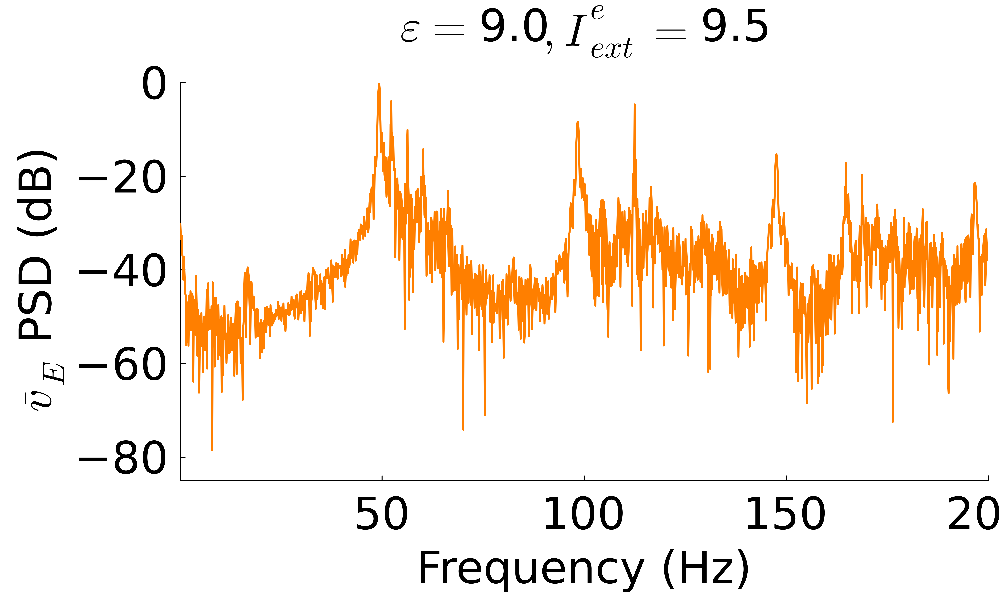

In [575]:
gr()
plot = scatter()
plot!(freqs,10*log10.(normalized),linewidth=2,grid=false,legend=false,color="darkorange1",dpi=500)
plot!(xtickfont=30,ytickfont=30,xlims=(freqs[2],200),ylims=(-85,0))
plot!(title=L"\epsilon = " * string(p.scalar_params[15]) * L", I_{ext}^e = " * string(p.scalar_params[14]) ,titlefont = font(30),top_margin = 10mm,left_margin=20mm)
xlabel!("Frequency (Hz)",xguidefontsize=30,bottom_margin = 10mm)
ylabel!(L"\bar{v}_E"*" PSD (dB)",yguidefontsize=30,left_margin = 10mm)
plot!(xtickfont=30,ytickfont=30)
plot!(size=(1000, 600))
savefig(plot,"Fourier10/PSDMean_eps" * string(p.scalar_params[15])*".png")
display(plot)